# Notebook #3: Gestión de Outliers

In [ ]:
%load_ext autoreload
%autoreload 2

# Tratamiento de datos
# -----------------------------------------------------------------------
import pandas as pd
import numpy as np
import pickle

# Configuración
# -----------------------------------------------------------------------
pd.set_option('display.max_columns', None) # para poder visualizar todas las columnas de los DataFrames

# Ignorar los warnings
# -----------------------------------------------------------------------
import warnings
warnings.filterwarnings('ignore')

# Librería para el acceso a variables y funciones
# -----------------------------------------------------------------------
import sys
sys.path.append("../../")
#from src import soporte_asunciones as sa
from src import soporte_preprocesamiento as sp
from src import soporte_nulos as sn

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


- Importamos el dataframe generado en el notebook anterior.

In [ ]:
df = pd.read_pickle('../datos/pickles_transformados/modelo1/df_encoded.pkl')
df.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating
0,51,0,0.161628,0.161628,6,0.161628,0.161628,0.161628,0.161628,0.161628,0.161628,131160,1.0,11,0.161628,1.0,0.161628,1,0,0,0.161628,0.161628,0.161628,0.161628,0.161628
1,31,1,0.161628,0.161628,10,0.161628,0.080814,0.080814,0.080814,0.161628,0.161628,41890,0.0,23,0.161628,6.0,0.161628,5,1,4,0.080814,0.161628,0.161628,0.161628,0.161628
2,32,0,0.580814,0.580814,17,0.161628,0.161628,0.161628,0.161628,0.161628,0.080814,193280,1.0,15,0.161628,5.0,0.161628,5,0,3,0.161628,0.580814,0.161628,0.080814,0.080814
3,38,0,0.161628,0.387209,2,0.161628,0.387209,0.080814,0.161628,0.161628,0.053876,83210,3.0,11,0.080814,13.0,0.161628,8,7,5,0.161628,0.080814,0.161628,0.580814,0.053876
4,32,0,0.080814,0.290407,10,0.580814,0.161628,0.053876,0.387209,0.080814,0.580814,23420,4.0,12,0.161628,9.0,0.080814,6,0,4,0.080814,0.161628,0.080814,0.053876,0.040407


- Transformamos las columnas que deben ser categóricas pero durante el encoding se han convertido en numéricas.

In [4]:
df[['Attrition', 'BusinessTravel', 'Department', 'Education',
       'EducationField', 'Gender', 'JobLevel', 'JobRole', 'MaritalStatus',
       'StockOptionLevel', 'TrainingTimesLastYear', 'EnvironmentSatisfaction',
       'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement',
       'PerformanceRating']] = df[['Attrition', 'BusinessTravel', 'Department', 'Education',
       'EducationField', 'Gender', 'JobLevel', 'JobRole', 'MaritalStatus',
       'StockOptionLevel', 'TrainingTimesLastYear', 'EnvironmentSatisfaction',
       'JobSatisfaction', 'WorkLifeBalance', 'JobInvolvement',
       'PerformanceRating']].astype(str)

In [5]:
col_numericas = df.select_dtypes(include=np.number).columns
contaminacion = [0.01, 0.05]
estimadores = [25, 50, 75]

outliers = sn.outliers_isolation_forest(df, contaminacion, estimadores)
outliers.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,JobInvolvement,PerformanceRating,outliers_ifo_0.01_25,outliers_ifo_0.01_50,outliers_ifo_0.01_75,outliers_ifo_0.05_25,outliers_ifo_0.05_50,outliers_ifo_0.05_75
0,51,0,0.16162790697674417,0.16162790697674417,6,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,131160,1.0,11,0.16162790697674417,1.0,0.16162790697674417,1,0,0,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,1,1,1,1,1,1
1,31,1,0.16162790697674417,0.16162790697674417,10,0.16162790697674417,0.08081395348837209,0.08081395348837209,0.08081395348837209,0.16162790697674417,0.16162790697674417,41890,0.0,23,0.16162790697674417,6.0,0.16162790697674417,5,1,4,0.08081395348837209,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,1,1,1,1,1,1
2,32,0,0.5808139534883721,0.5808139534883721,17,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.16162790697674417,0.08081395348837209,193280,1.0,15,0.16162790697674417,5.0,0.16162790697674417,5,0,3,0.16162790697674417,0.5808139534883721,0.16162790697674417,0.08081395348837209,0.08081395348837209,1,1,1,1,1,1
3,38,0,0.16162790697674417,0.3872093023255814,2,0.16162790697674417,0.3872093023255814,0.08081395348837209,0.16162790697674417,0.16162790697674417,0.05387596899224806,83210,3.0,11,0.08081395348837209,13.0,0.16162790697674417,8,7,5,0.16162790697674417,0.08081395348837209,0.16162790697674417,0.5808139534883721,0.05387596899224806,1,1,1,1,1,1
4,32,0,0.08081395348837209,0.29040697674418603,10,0.5808139534883721,0.16162790697674417,0.05387596899224806,0.3872093023255814,0.08081395348837209,0.5808139534883721,23420,4.0,12,0.16162790697674417,9.0,0.08081395348837209,6,0,4,0.08081395348837209,0.16162790697674417,0.08081395348837209,0.05387596899224806,0.04040697674418604,1,1,1,1,1,1


- Aplicaremos ahora un filtro para quedarmos con aquellos registros donde, 4 de 6 combinaciones resulten ser outliers.

In [6]:
cantidad_col = 4
df_filtrado = df[(df == -1).sum(axis=1) > cantidad_col]
df_filtrado.shape

(42, 31)

- Vemos que, nos hemos quedado sin outliers en el DF filtrado.

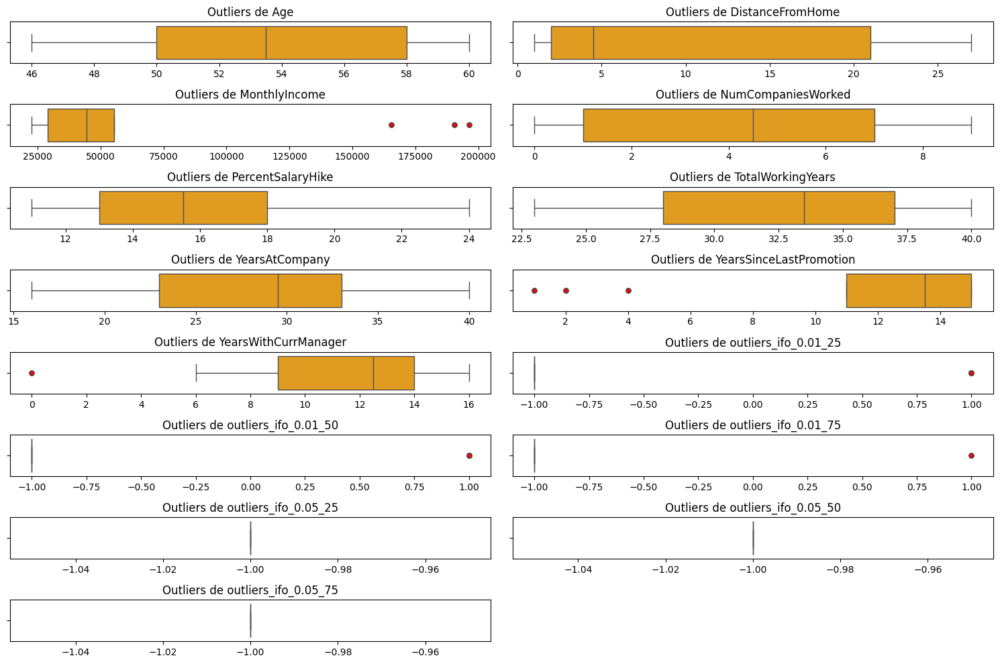

In [7]:
sp.detectar_outliers(df_filtrado)

- En total, hemos identificado sólamente 40 outliers, de un total de unos 3400 registros. Por ese motivo, en este primer modelo, los eliminaremos del dataset.

In [8]:
df = df.drop(df_filtrado.index)

In [9]:
col_numericas

Index(['Age', 'DistanceFromHome', 'MonthlyIncome', 'NumCompaniesWorked',
       'PercentSalaryHike', 'TotalWorkingYears', 'YearsAtCompany',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')

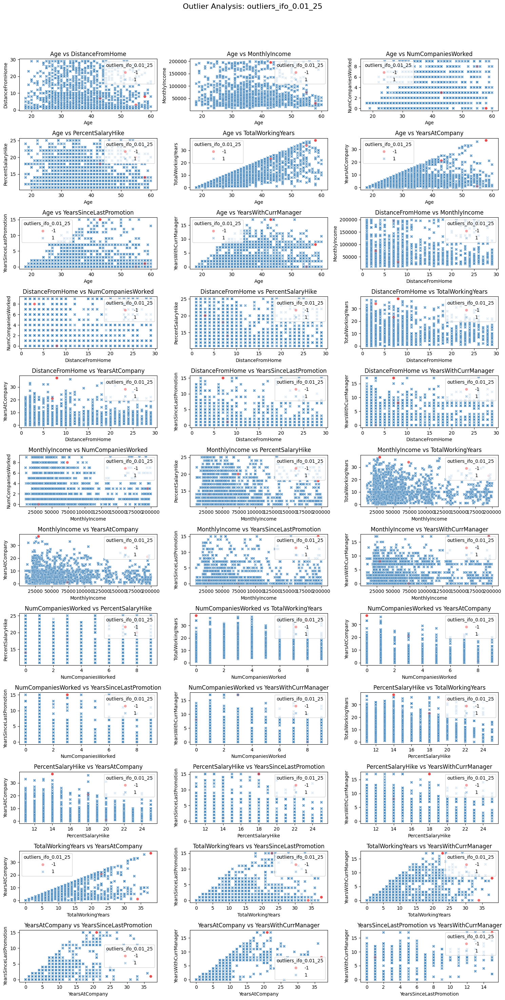

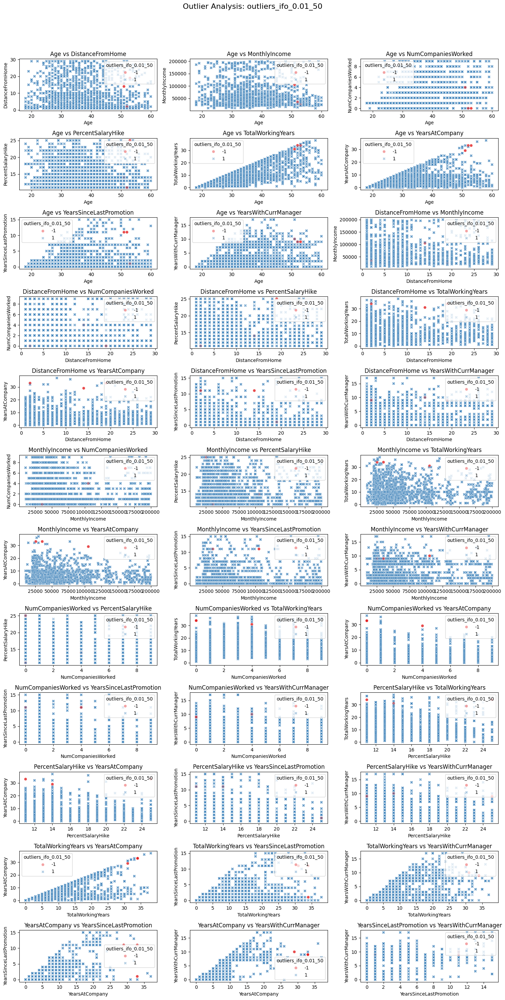

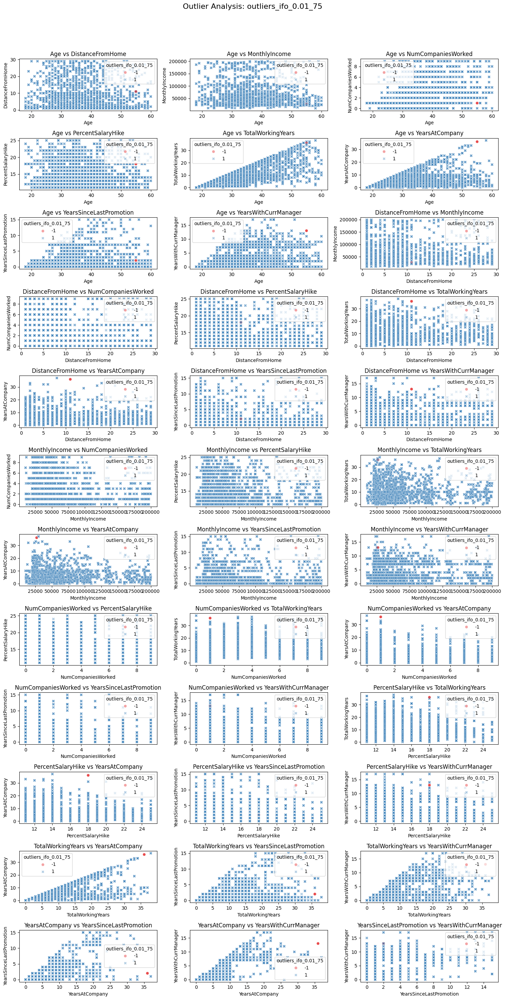

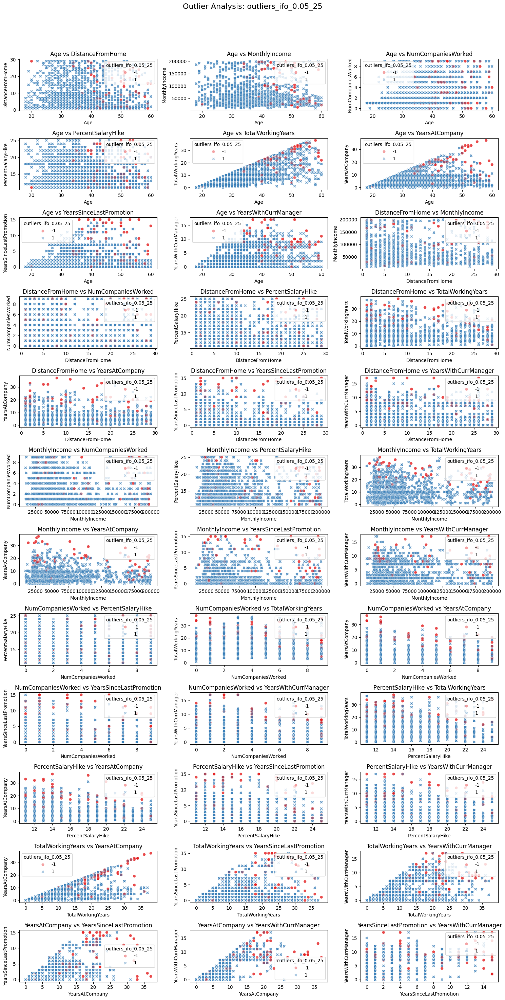

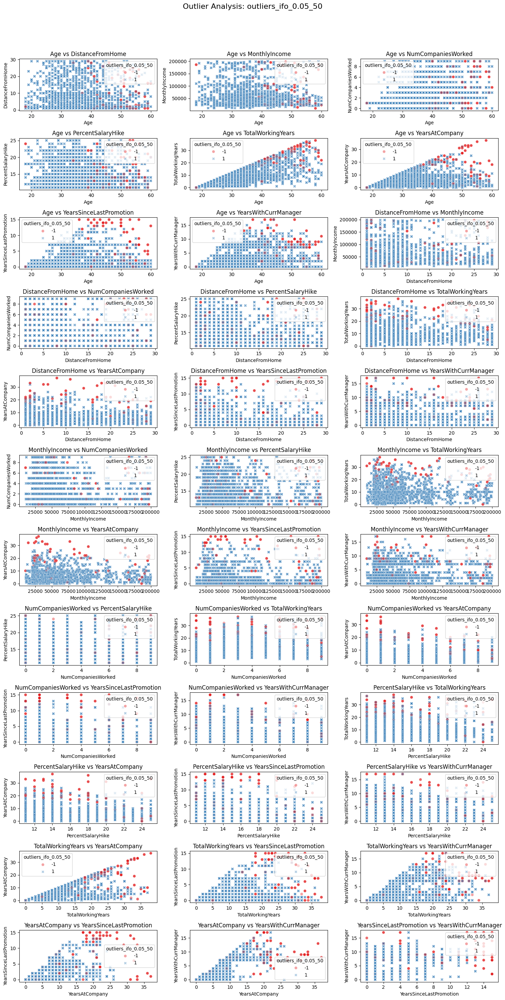

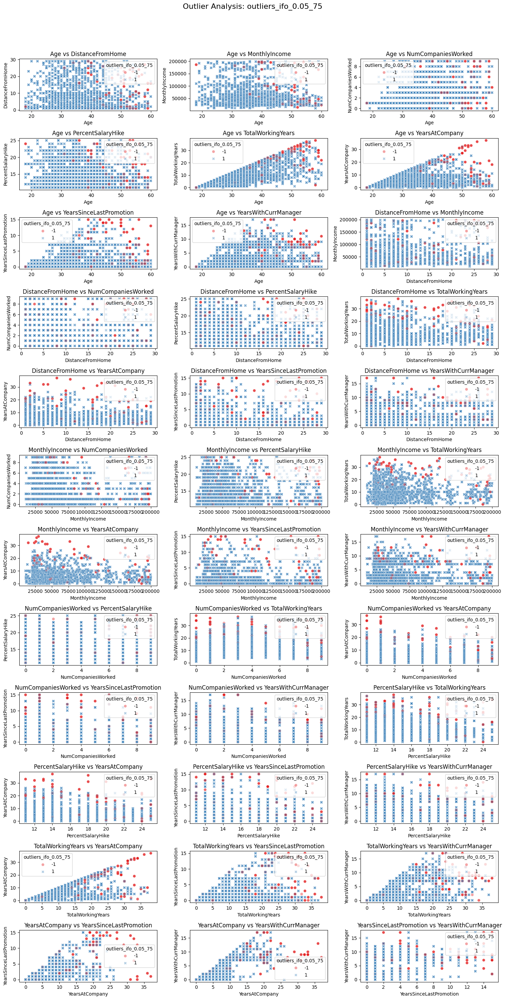

In [10]:
sn.visualizar_outliers(df, col_numericas, figsize=(15,30))

In [13]:
df.drop(columns= ['outliers_ifo_0.01_25', 'outliers_ifo_0.01_50', 'outliers_ifo_0.01_75',
       'outliers_ifo_0.05_25', 'outliers_ifo_0.05_50', 'outliers_ifo_0.05_75'], inplace= True)

In [ ]:
with open('../datos/pickles_transformados/modelo1/df_sinoutliers.pkl', 'wb') as f:
    pickle.dump(df, f)